In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
#from Ipython.display import Image, display
import bar_chart_race as bcr
import warnings
warnings.filterwarnings('ignore')
sns.set(style = 'darkgrid')

d:\Users\nikhi\anaconda3\Lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [20]:
df = pd.read_csv(r"C:\Users\nikhi\Downloads\Vehicles dataset.csv")

In [21]:
df.head()

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
0,JTMEB3FV6N,Monroe,Key West,FL,33040,2022,TOYOTA,RAV4 PRIME,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,42,0,NaN,198968248,POINT (-81.80023 24.5545),NaN,12087972100
1,1G1RD6E45D,Clark,Laughlin,NV,89029,2013,CHEVROLET,VOLT,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,NaN,5204412,POINT (-114.57245 35.16815),NaN,32003005702
2,JN1AZ0CP8B,Yakima,Yakima,WA,98901,2011,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,73,0,15.0,218972519,POINT (-120.50721 46.60448),PACIFICORP,53077001602
3,1G1FW6S08H,Skagit,Concrete,WA,98237,2017,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,238,0,39.0,186750406,POINT (-121.7515 48.53892),PUGET SOUND ENERGY INC,53057951101
4,3FA6P0SU1K,Snohomish,Everett,WA,98201,2019,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,38.0,2006714,POINT (-122.20596 47.97659),PUGET SOUND ENERGY INC,53061041500


In [22]:
df.columns

Index(['VIN (1-10)', 'County', 'City', 'State', 'Postal Code', 'Model Year',
       'Make', 'Model', 'Electric Vehicle Type',
       'Clean Alternative Fuel Vehicle (CAFV) Eligibility', 'Electric Range',
       'Base MSRP', 'Legislative District', 'DOL Vehicle ID',
       'Vehicle Location', 'Electric Utility', '2020 Census Tract'],
      dtype='object')

In [23]:
df.columns = df.columns.str.replace(" ","_")

In [24]:
df.columns = df.columns.str.strip().str.lower()

In [25]:
df.shape

(112634, 17)

In [26]:
df.describe()

,postal_code,model_year,electric_range,base_msrp,legislative_district,dol_vehicle_id,2020_census_tract
count,112634.000000,112634.000000,112634.000000,112634.000000,112348.000000,1.126340e+05,1.126340e+05
mean,98156.226850,2019.003365,87.812987,1793.439681,29.805604,1.994567e+08,5.296650e+10
std,2648.733064,2.892364,102.334216,10783.753486,14.700545,9.398427e+07,1.699104e+09
min,1730.000000,1997.000000,0.000000,0.000000,1.000000,4.777000e+03,1.101001e+09
25%,98052.000000,2017.000000,0.000000,0.000000,18.000000,1.484142e+08,5.303301e+10
50%,98119.000000,2020.000000,32.000000,0.000000,34.000000,1.923896e+08,5.303303e+10
75%,98370.000000,2022.000000,208.000000,0.000000,43.000000,2.191899e+08,5.305307e+10
max,99701.000000,2023.000000,337.000000,845000.000000,49.000000,4.792548e+08,5.603300e+10


In [27]:
df.isna().sum()

vin_(1-10)                                             0
county                                                 0
city                                                   0
state                                                  0
postal_code                                            0
model_year                                             0
make                                                   0
model                                                 20
electric_vehicle_type                                  0
clean_alternative_fuel_vehicle_(cafv)_eligibility      0
electric_range                                         0
base_msrp                                              0
legislative_district                                 286
dol_vehicle_id                                         0
vehicle_location                                      24
electric_utility                                     443
2020_census_tract                                      0
dtype: int64

In [28]:
df.model.value_counts().reset_index().head()

,model,count
0,MODEL 3,23135
1,MODEL Y,17142
2,LEAF,12880
3,MODEL S,7377
4,BOLT EV,4910


In [29]:
df.legislative_district.value_counts().reset_index().head()

,legislative_district,count
0,41.0,7605
1,45.0,7112
2,48.0,6462
3,36.0,5251
4,46.0,4723


In [30]:
df.vehicle_location.value_counts().reset_index().head()

,vehicle_location,count
0,POINT (-122.13158 47.67858),2916
1,POINT (-122.2066 47.67887),2059
2,POINT (-122.1872 47.61001),2001
3,POINT (-122.31765 47.70013),1880
4,POINT (-122.12096 47.55584),1852


In [31]:
df.electric_utility.value_counts().reset_index().head()

,electric_utility,count
0,PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),40247
1,PUGET SOUND ENERGY INC,22172
2,CITY OF SEATTLE - (WA)|CITY OF TACOMA - (WA),21447
3,BONNEVILLE POWER ADMINISTRATION||PUD NO 1 OF C...,6522
4,BONNEVILLE POWER ADMINISTRATION||CITY OF TACOM...,5053


In [32]:
import pandas as pd

# Filling missing values in 'Legislative District' with the most frequent value (mode)
df['legislative_district'] = df['legislative_district'].fillna(df['legislative_district'].mode()[0])

# Filling missing values in 'Model' with mode (most frequent model)
df['model'] = df['model'].fillna(df['model'].mode()[0])

# Filling missing values in 'Electric Utility' using backward fill
df['electric_utility'] = df['electric_utility'].fillna(method='bfill')

# If you want to fill with a custom value, for example, for Electric Utility:
# df['Electric Utility'] = df['Electric Utility'].fillna('Unknown Utility')


In [33]:
import pandas as pd

# Assuming your dataframe is named df
mode_value = df['vehicle_location'].mode()[0]  # Get the mode of the column

# Replace NaN values with the mode
df['vehicle_location'].fillna(mode_value, inplace=True)


In [34]:
df.isnull().sum()

vin_(1-10)                                           0
county                                               0
city                                                 0
state                                                0
postal_code                                          0
model_year                                           0
make                                                 0
model                                                0
electric_vehicle_type                                0
clean_alternative_fuel_vehicle_(cafv)_eligibility    0
electric_range                                       0
base_msrp                                            0
legislative_district                                 0
dol_vehicle_id                                       0
vehicle_location                                     0
electric_utility                                     0
2020_census_tract                                    0
dtype: int64

# Univariate Analysis

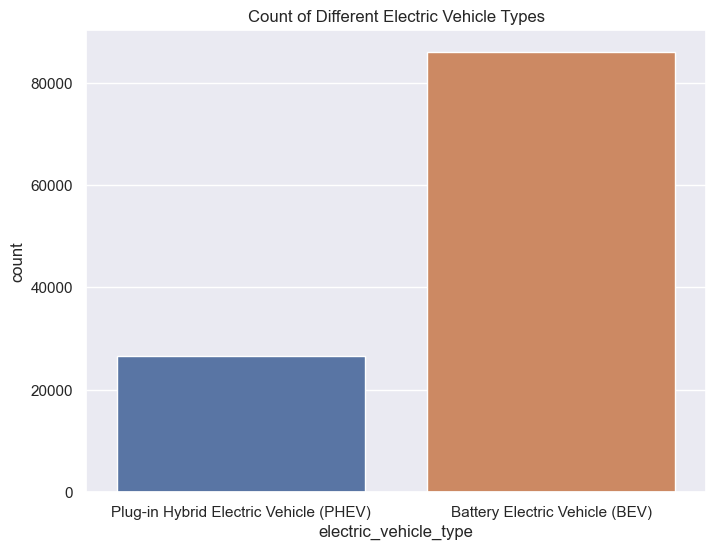

In [32]:
plt.figure(figsize=(8, 6))
sns.countplot(x='electric_vehicle_type', data=df)
plt.title('Count of Different Electric Vehicle Types')
plt.xticks
plt.show()

The bar plot displays the count of different electric vehicle types, specifically comparing Plug-in Hybrid Electric Vehicles (PHEVs) and **Battery Electric Vehicles (BEVs)**.
- **Battery Electric Vehicles (BEVs)** have a significantly higher count compared to **Plug-in Hybrid Electric Vehicles (PHEVs)**.
- BEVs seem to be over three times as common as PHEVs in the dataset.
- The chart indicates a greater adoption or presence of fully electric vehicles (BEVs) compared to hybrid models (PHEVs).

This suggests that the dataset reflects a trend favoring fully electric vehicles over hybrid models.

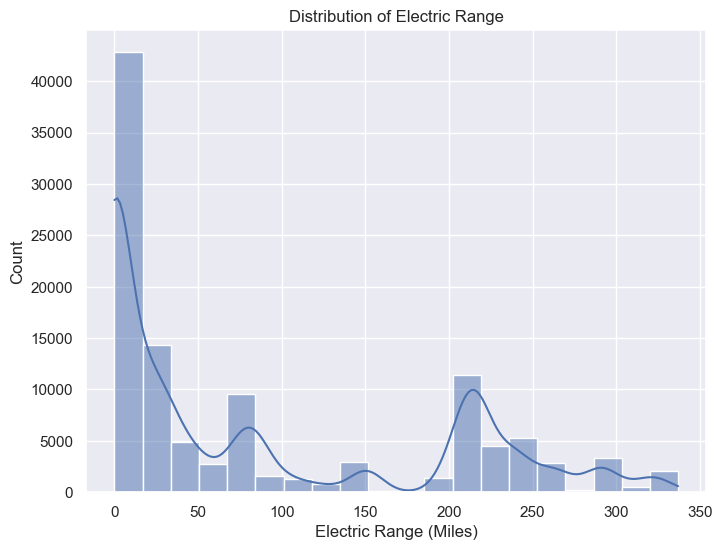

In [22]:
plt.figure(figsize=(8, 6))
sns.histplot(df['electric_range'], kde=True, bins=20)
plt.title('Distribution of Electric Range')
plt.xlabel('Electric Range (Miles)')
plt.show()

This distribution suggests that most vehicles in the dataset have relatively low electric ranges, but a subset of vehicles offers a much higher range, likely reflecting advancements in battery technology.








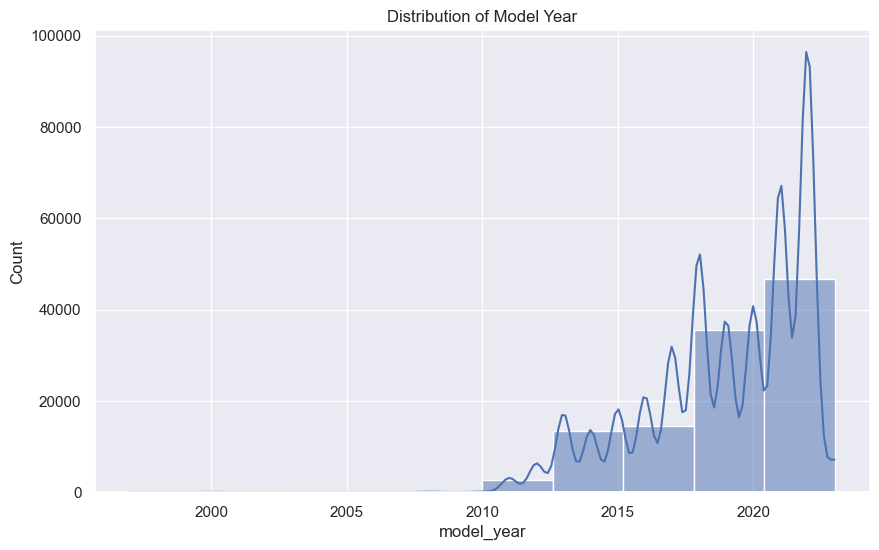

In [27]:
plt.figure(figsize=(10, 6))
sns.histplot(df['model_year'], kde=True, bins=10)
plt.title('Distribution of Model Year')
plt.show()

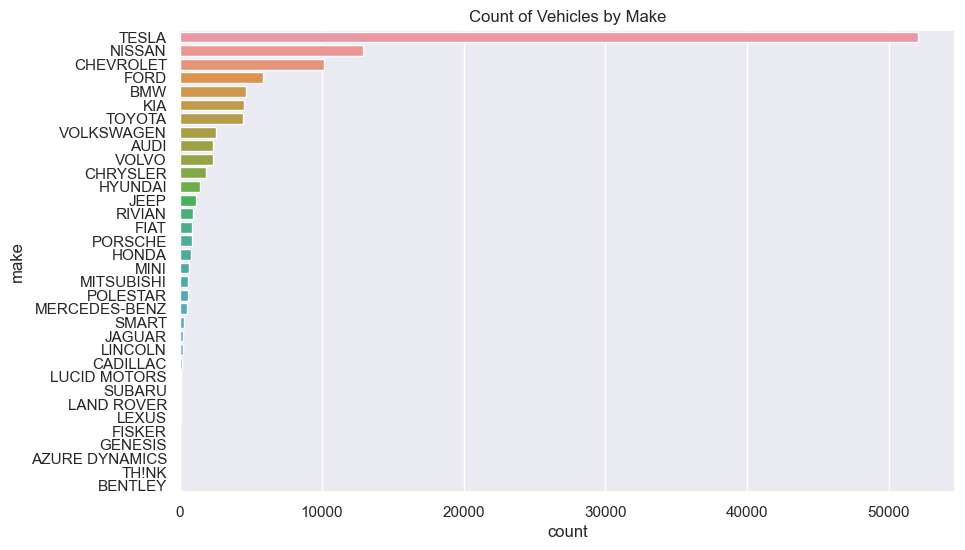

In [29]:
plt.figure(figsize=(10, 6))
sns.countplot(y='make', data=df, order=df['make'].value_counts().index)
plt.title('Count of Vehicles by Make')
plt.show()

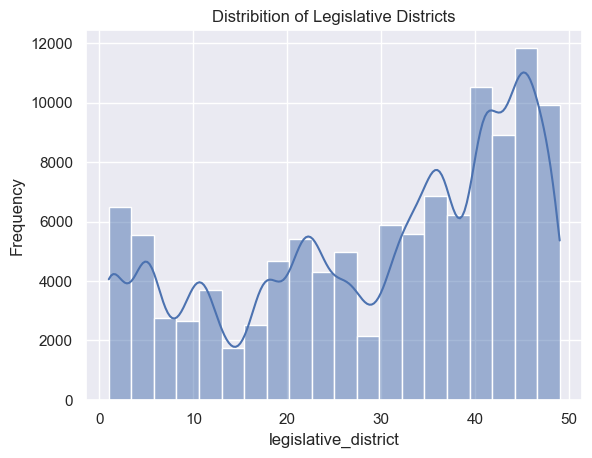

In [34]:
sns.histplot(df['legislative_district'], kde=True, bins=20)
plt.title("Distribition of Legislative Districts")
plt.xlabel("legislative_district")
plt.ylabel("Frequency")
plt.show()

# BiVariate analysis

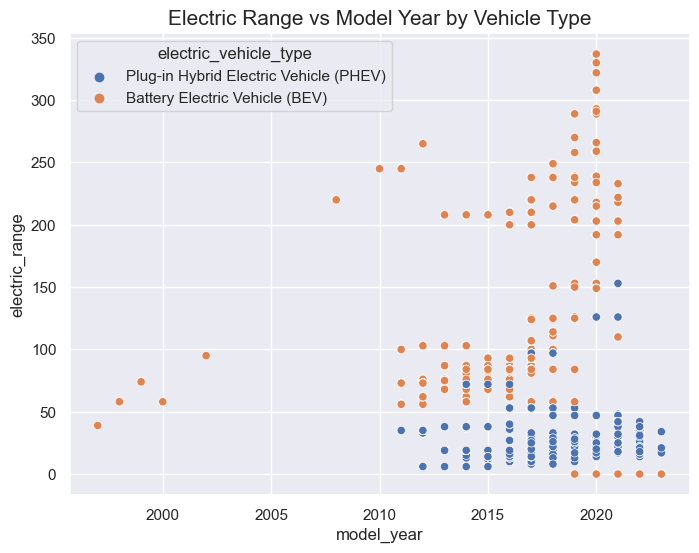

In [40]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='model_year', y='electric_range', data=df, hue='electric_vehicle_type')
plt.title('Electric Range vs Model Year by Vehicle Type')
plt.show()


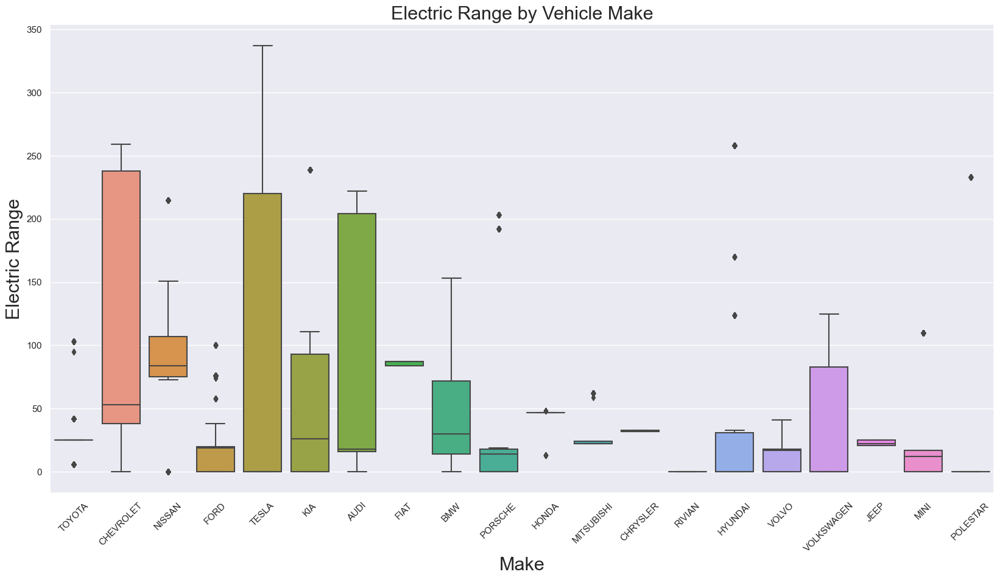

In [59]:
plt.figure(figsize=(20, 10))
top_makes = df['make'].value_counts().nlargest(20).index
ax = sns.boxplot(x='make', y='electric_range', data=df[df['make'].isin(top_makes)])
plt.title('Electric Range by Vehicle Make',fontsize = 22)
plt.xlabel('Make',fontsize = 22)
plt.ylabel("Electric Range",fontsize = 22)
plt.xticks(rotation=45)
plt.show()

for i, box in enumerate(ax.artists):
    y = box.get_ydata()
    median = round(data[data['make'] == top_makes[i]]['electric_range'].median(),2)
    plt.text(i, median + 10, f"{median}",ha = 'center',fontsize = 20)
plt.show()

The box plot shows the electric range for various vehicle makes.

Tesla and Audi have the highest electric range, with a wider distribution indicating a variety of models.
Chevrolet and BMW have moderate ranges, while Ford and Nissan exhibit lower ranges.
Some brands like Honda and Mitsubishi have smaller ranges, and a few outliers exist for several makes.
The spread of ranges varies significantly, indicating different capabilities across brands.

### This bar plot helps compare the average Base MSRP for different electric vehicle types.


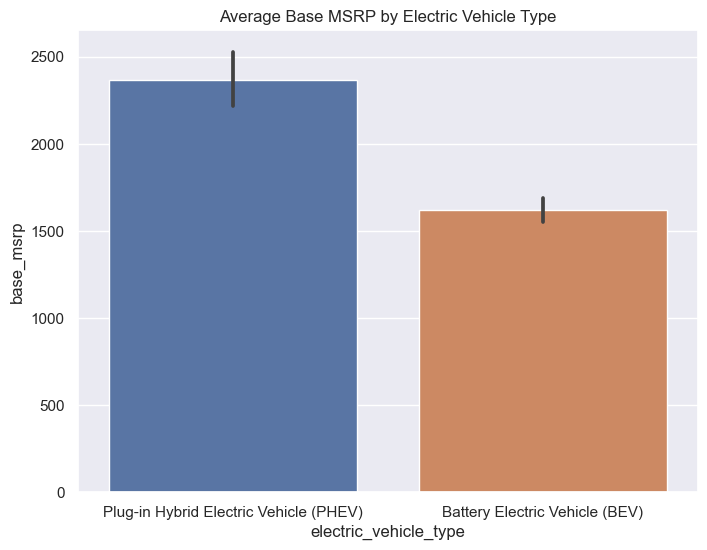

In [62]:
# Bivariate plot: Electric Vehicle Type vs Base MSRP
plt.figure(figsize=(8, 6))
sns.barplot(x='electric_vehicle_type', y='base_msrp', data=df)
plt.title('Average Base MSRP by Electric Vehicle Type')
plt.show()


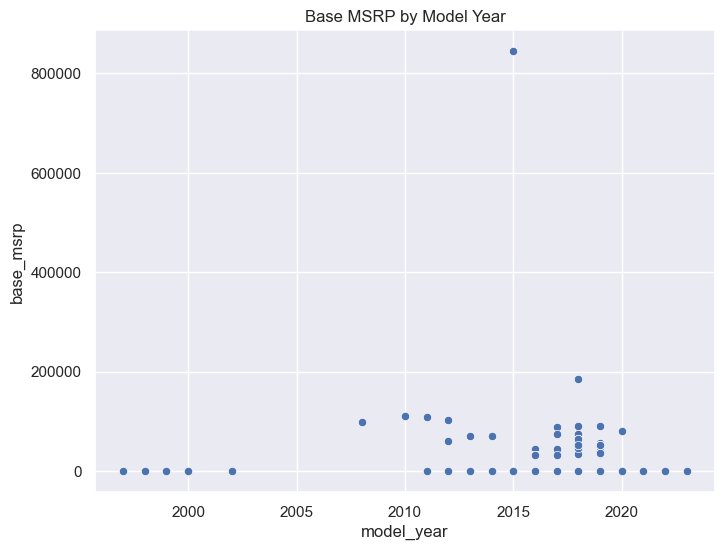

In [74]:
# Bivariate plot: Model Year vs Base MSRP
plt.figure(figsize=(8, 6))
sns.scatterplot(x='model_year', y='base_msrp', data=df)
plt.title('Base MSRP by Model Year')
plt.show()


## Task-2 Create a Choropleth using plotly.express to display the number of EV vehicles based on location

In [3]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [12]:
import pandas as pd
import plotly.express as px

In [39]:
ev_count_by_state = df.groupby('state').size().reset_index(name = 'ev_count')

#creating the choropleth map
fig = px.choropleth(
      ev_count_by_state,
      locations = 'state', # columns representing state code(i.e.'FL')
      locationmode = 'USA-states', #this maps to 'US-states'
      color = 'ev_count', # color by count of electric vehicles
      color_continuous_scale ='reds',# color scale
      scope = 'usa',#restricts map to USA
      labels = {'ev_count':'Number of EVs'},# color leged
      title = 'Number of Electric Vehicles by state'
)
#Update the layout fo visualization

fig.update_layout(
    geo = dict(bgcolor = 'rgba(0,0,0,0)'),
    title_x = 0.8
)

#display map
fig.show()

In [35]:
df.head()

,vin_(1-10),county,city,state,postal_code,model_year,make,model,electric_vehicle_type,clean_alternative_fuel_vehicle_(cafv)_eligibility,electric_range,base_msrp,legislative_district,dol_vehicle_id,vehicle_location,electric_utility,2020_census_tract
0,JTMEB3FV6N,Monroe,Key West,FL,33040,2022,TOYOTA,RAV4 PRIME,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,42,0,41.0,198968248,POINT (-81.80023 24.5545),PACIFICORP,12087972100
1,1G1RD6E45D,Clark,Laughlin,NV,89029,2013,CHEVROLET,VOLT,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,41.0,5204412,POINT (-114.57245 35.16815),PACIFICORP,32003005702
2,JN1AZ0CP8B,Yakima,Yakima,WA,98901,2011,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,73,0,15.0,218972519,POINT (-120.50721 46.60448),PACIFICORP,53077001602
3,1G1FW6S08H,Skagit,Concrete,WA,98237,2017,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,238,0,39.0,186750406,POINT (-121.7515 48.53892),PUGET SOUND ENERGY INC,53057951101
4,3FA6P0SU1K,Snohomish,Everett,WA,98201,2019,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,38.0,2006714,POINT (-122.20596 47.97659),PUGET SOUND ENERGY INC,53061041500


# Task 3: Create a Racing Bar Plot to display the animation of EV Make and its count each year.


In [64]:
import bar_chart_race as bcr
df_counts = df.groupby(['model_year', 'make']).size().unstack(fill_value=0)

In [78]:
bcr.bar_chart_race(
    df=df_counts,
    filename='ev_make_race.gif',  # Change output file to GIF
    title='Electric Vehicle Make Count Over Time',
    period_length=3000,
    sort ='desc',
    n_bars = 10,
    steps_per_period = 45,
    figsize=(10, 6),  # Adjust figure size (width, height)
    title_size=10,  # Title size
    bar_label_size= 10 # Speed of the animation
)


MovieWriter imagemagick unavailable; using Pillow instead.


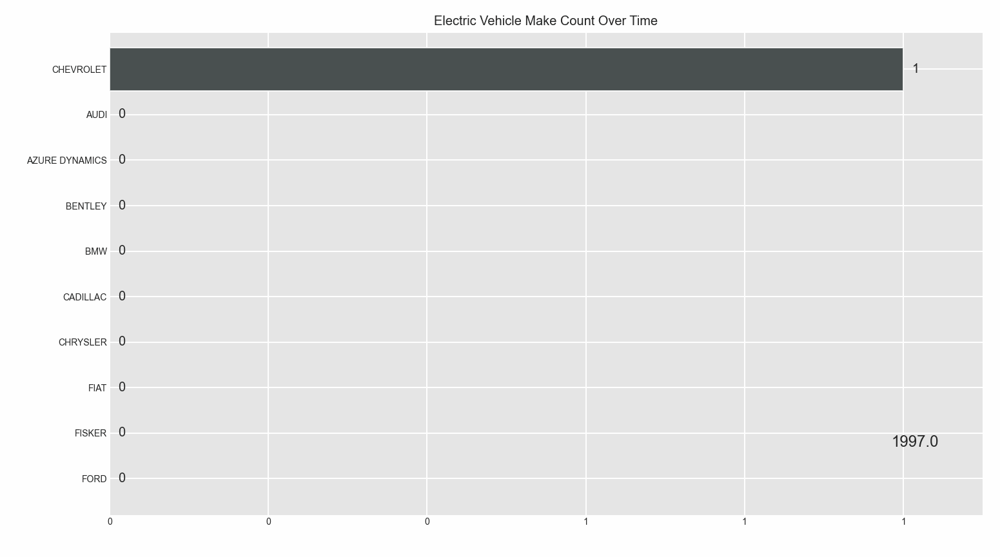

In [79]:
from IPython.display import Image

Image("ev_make_race.gif")

# Conclusion

The dataset serves as a valuable resource for understanding the current landscape of electric vehicles in the market. It provides insights into consumer preferences, technological advancements, and the evolving automotive industry’s response to environmental concerns. As electric vehicle technology continues to advance, ongoing analysis will be essential to track these trends and support informed decisions by manufacturers, policymakers, and consumers alike.